# Electricity Price Prediction

Goal:
- predict the electricity price for the next 24 hours
- predict the electricity price for the next 7 days

We will consider deterministic and stochastic models.

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns 
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import adfuller, kpss, ccf

sns.set_style('darkgrid')

## 1 Load data

In [3]:
data_file = './data/model_ready.parquet'
df = pd.read_parquet(data_file, "pyarrow")
df.head()

,central_mtlf_fc,north_mtlf_fc,south_mtlf_fc,system_mtlf_fc,ia_ksux_ws_mph_fc,il_kmdw_ws_mph_fc,il_kord_ws_mph_fc,mi_kanj_ws_mph_fc,mi_karb_ws_mph_fc,mi_kazo_ws_mph_fc,...,mi_klan_td_f_fc,mn_kinl_td_f_fc,mn_kpqn_td_f_fc,mo_ksgf_td_f_fc,mo_kstl_td_f_fc,oh_kluk_td_f_fc,ok_klaw_td_f_fc,da_energy_aeci_lmpexpost_ac,da_energy_michigan_hub_lmpexpost_ac,da_energy_minn_hub_lmpexpost_ac
interval_ending_dt_utc,,,,,,,,,,,,,,,,,,,,,
2021-07-31 01:00:00,44380.0,20398.0,28946.0,93724.0,4.023245,4.470273,4.470273,3.129191,2.682164,2.682164,...,11.111111,12.777778,17.777778,21.666667,20.0,16.111111,17.777778,37.62,38.13,42.86
2021-07-31 02:00:00,42821.0,19659.0,27916.0,90396.0,4.157354,4.023245,3.889137,2.548055,2.101028,2.235136,...,11.111111,13.333333,17.222222,21.833333,20.0,16.277778,18.333333,36.32,35.76,39.28
2021-07-31 03:00:00,40950.0,19112.0,26880.0,86942.0,4.336165,3.576218,3.263299,1.922217,1.475190,1.788109,...,11.111111,13.888889,16.666667,22.055556,20.0,16.500000,18.888889,32.86,32.51,34.54
2021-07-31 04:00:00,38229.0,18106.0,25453.0,81788.0,4.470273,3.129191,2.682164,1.341082,0.894055,1.341082,...,11.111111,14.444444,16.111111,22.222222,20.0,16.666667,19.444444,29.01,29.46,33.05
2021-07-31 05:00:00,36287.0,16900.0,23928.0,77115.0,4.023245,2.235136,1.922217,1.341082,0.581135,1.028163,...,11.111111,13.888889,15.944444,22.055556,20.0,16.500000,19.611111,28.20,30.35,28.58


In [4]:
df.tail()

,central_mtlf_fc,north_mtlf_fc,south_mtlf_fc,system_mtlf_fc,ia_ksux_ws_mph_fc,il_kmdw_ws_mph_fc,il_kord_ws_mph_fc,mi_kanj_ws_mph_fc,mi_karb_ws_mph_fc,mi_kazo_ws_mph_fc,...,mi_klan_td_f_fc,mn_kinl_td_f_fc,mn_kpqn_td_f_fc,mo_ksgf_td_f_fc,mo_kstl_td_f_fc,oh_kluk_td_f_fc,ok_klaw_td_f_fc,da_energy_aeci_lmpexpost_ac,da_energy_michigan_hub_lmpexpost_ac,da_energy_minn_hub_lmpexpost_ac
interval_ending_dt_utc,,,,,,,,,,,,,,,,,,,,,
2021-07-30 20:00:00,48950.0,21120.0,31730.0,101790.0,5.230219,4.023245,3.576218,5.051408,3.442110,2.816272,...,9.277778,11.277778,16.277778,20.944444,18.888889,16.500000,18.722222,51.51,48.72,55.51
2021-07-30 21:00:00,49200.0,21350.0,31920.0,102470.0,4.604381,4.023245,3.576218,5.677246,3.263299,2.995083,...,9.055556,11.500000,16.500000,20.722222,18.888889,16.277778,18.500000,55.43,50.97,54.82
2021-07-30 22:00:00,49210.0,21520.0,31790.0,102520.0,4.023245,4.023245,3.576218,6.258382,3.129191,3.129191,...,8.888889,11.666667,16.666667,20.555556,18.888889,16.111111,18.333333,53.32,53.57,56.44
2021-07-30 23:00:00,48520.0,21530.0,31180.0,101230.0,4.023245,4.023245,3.576218,5.677246,2.995083,2.995083,...,9.055556,12.222222,17.055556,20.722222,18.888889,16.111111,18.166667,46.39,49.63,52.06
2021-07-31 00:00:00,46870.0,21210.0,30170.0,98260.0,4.023245,4.023245,3.576218,5.051408,2.816272,2.816272,...,9.277778,12.777778,17.388889,20.944444,18.888889,16.111111,17.944444,43.27,41.85,46.88


**Issue 1:** The time series index seems not increasing. We need to sort the data by time.


In [5]:
df = df.sort_index()
print(df.head())
print(df.tail())

                        central_mtlf_fc  north_mtlf_fc  south_mtlf_fc  \
interval_ending_dt_utc                                                  
2019-09-01 00:00:00             39290.0        16050.0        27040.0   
2019-09-01 01:00:00             39644.0        15757.0        25871.0   
2019-09-01 02:00:00             39184.0        15820.0        25163.0   
2019-09-01 03:00:00             37378.0        15484.0        24112.0   
2019-09-01 04:00:00             35104.0        14701.0        22690.0   

                        system_mtlf_fc  ia_ksux_ws_mph_fc  il_kmdw_ws_mph_fc  \
interval_ending_dt_utc                                                         
2019-09-01 00:00:00            82370.0           4.157354           4.023245   
2019-09-01 01:00:00            81272.0           4.470273           4.023245   
2019-09-01 02:00:00            80167.0           4.157354           3.889137   
2019-09-01 03:00:00            76974.0           3.889137           3.710326   
2019-09-

Now we see the time series starts from 9/1/2019 and ends at 8/30/2021.
Therefore, this is a 2-year data set with an hourly step.

### 1.1 Understand Data
feature columns:
- load `mtlf`
- wind `ws`
- dew point `td`

target columns: energy prices at three locations
- day ahead energy price `da-energy-**` 

In [6]:
columns = df.columns 

# separte names for inspection
load_names = []
wind_names = []
dewpoint_names = []
target_names = []
for col in columns:
    if 'mtlf' in col:
        load_names.append(col)
    if 'ws' in col:
        wind_names.append(col)
    if 'td' in col:
        dewpoint_names.append(col)
    if 'da_energy' in col:
        target_names.append(col)
        
print(len(load_names) + len(wind_names) + len(dewpoint_names) + len(target_names))
print(len(columns))

41
41


In [7]:
# load at different parts: system = central + north + south?
load_names

['central_mtlf_fc', 'north_mtlf_fc', 'south_mtlf_fc', 'system_mtlf_fc']

In [8]:
wind_names

['ia_ksux_ws_mph_fc',
 'il_kmdw_ws_mph_fc',
 'il_kord_ws_mph_fc',
 'mi_kanj_ws_mph_fc',
 'mi_karb_ws_mph_fc',
 'mi_kazo_ws_mph_fc',
 'mi_klan_ws_mph_fc',
 'mn_kinl_ws_mph_fc',
 'mn_krst_ws_mph_fc',
 'mo_kstl_ws_mph_fc',
 'oh_kakr_ws_mph_fc',
 'ok_kclk_ws_mph_fc',
 'ok_kokc_ws_mph_fc',
 'ok_ktul_ws_mph_fc',
 'ok_kwdg_ws_mph_fc',
 'sc_kchs_ws_mph_fc']

In [9]:
dewpoint_names

['ar_kjbr_td_f_fc',
 'ia_kdsm_td_f_fc',
 'ia_ksux_td_f_fc',
 'in_kfwa_td_f_fc',
 'in_kind_td_f_fc',
 'in_klaf_td_f_fc',
 'in_ksbn_td_f_fc',
 'ky_ksdf_td_f_fc',
 'la_kbtr_td_f_fc',
 'la_klch_td_f_fc',
 'la_kshv_td_f_fc',
 'mi_klan_td_f_fc',
 'mn_kinl_td_f_fc',
 'mn_kpqn_td_f_fc',
 'mo_ksgf_td_f_fc',
 'mo_kstl_td_f_fc',
 'oh_kluk_td_f_fc',
 'ok_klaw_td_f_fc']

In [10]:
target_names

['da_energy_aeci_lmpexpost_ac',
 'da_energy_michigan_hub_lmpexpost_ac',
 'da_energy_minn_hub_lmpexpost_ac']

### 1.2 Data Summary

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 17497 entries, 2019-09-01 00:00:00 to 2021-08-30 00:00:00
Data columns (total 41 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   central_mtlf_fc                      17497 non-null  float64
 1   north_mtlf_fc                        17497 non-null  float64
 2   south_mtlf_fc                        17497 non-null  float64
 3   system_mtlf_fc                       17497 non-null  float64
 4   ia_ksux_ws_mph_fc                    17497 non-null  float64
 5   il_kmdw_ws_mph_fc                    17497 non-null  float64
 6   il_kord_ws_mph_fc                    17497 non-null  float64
 7   mi_kanj_ws_mph_fc                    17497 non-null  float64
 8   mi_karb_ws_mph_fc                    17497 non-null  float64
 9   mi_kazo_ws_mph_fc                    17497 non-null  float64
 10  mi_klan_ws_mph_fc                    17497 non-null  float6

In [12]:
df.describe()

,central_mtlf_fc,north_mtlf_fc,south_mtlf_fc,system_mtlf_fc,ia_ksux_ws_mph_fc,il_kmdw_ws_mph_fc,il_kord_ws_mph_fc,mi_kanj_ws_mph_fc,mi_karb_ws_mph_fc,mi_kazo_ws_mph_fc,...,mi_klan_td_f_fc,mn_kinl_td_f_fc,mn_kpqn_td_f_fc,mo_ksgf_td_f_fc,mo_kstl_td_f_fc,oh_kluk_td_f_fc,ok_klaw_td_f_fc,da_energy_aeci_lmpexpost_ac,da_energy_michigan_hub_lmpexpost_ac,da_energy_minn_hub_lmpexpost_ac
count,17497.000000,17497.000000,17497.000000,17497.000000,17497.000000,17497.000000,17497.000000,17497.000000,17497.000000,17497.000000,...,17497.000000,17497.000000,17497.000000,17497.000000,17497.000000,17497.000000,17497.000000,17497.000000,17497.000000,17497.000000
mean,38282.406698,16599.165171,19434.893753,74315.786649,4.364457,4.219384,4.177644,3.331537,3.269896,3.302846,...,4.148162,-1.480339,2.098064,7.810123,7.076759,7.792279,8.971379,22.368501,27.223338,23.304362
std,6844.281408,2496.583698,3622.155051,12211.229965,2.470496,1.941427,2.028929,1.917858,2.042512,2.018022,...,9.959391,12.526915,11.739983,10.092110,10.187921,9.718024,9.136954,25.774993,17.024106,24.425206
min,23420.000000,10790.000000,12540.000000,49090.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,-20.000000,-38.888889,-35.555556,-26.111111,-23.333333,-17.777778,-22.222222,-22.120000,5.590000,-3.680000
25%,33460.000000,14810.000000,16990.000000,65850.000000,2.682164,2.816272,2.816272,1.922217,1.788109,1.788109,...,-3.888889,-10.000000,-6.111111,-0.388889,-0.944444,-0.166667,1.277778,15.020000,20.100000,15.510000
50%,37354.000000,16380.000000,18540.000000,72460.000000,3.889137,3.889137,3.889137,3.129191,3.129191,3.129191,...,2.944444,-2.777778,1.500000,7.388889,6.500000,7.611111,9.611111,19.240000,23.620000,19.740000
75%,41900.000000,18156.000000,21154.000000,80486.000000,5.811354,5.364327,5.364327,4.157354,4.470273,4.470273,...,13.333333,10.000000,12.611111,17.388889,16.666667,16.666667,17.777778,24.770000,28.880000,24.940000
max,66680.000000,26390.000000,33600.000000,119545.000000,17.434063,13.857845,13.857845,12.516764,13.857845,13.857845,...,24.444444,23.888889,25.555556,25.388889,24.277778,23.888889,23.166667,830.950000,376.630000,606.820000


In [13]:
# Check for missing values
df.isnull().sum().any()

False

In [14]:
# Any duplicated rows?
df.duplicated(keep="first").sum()

0

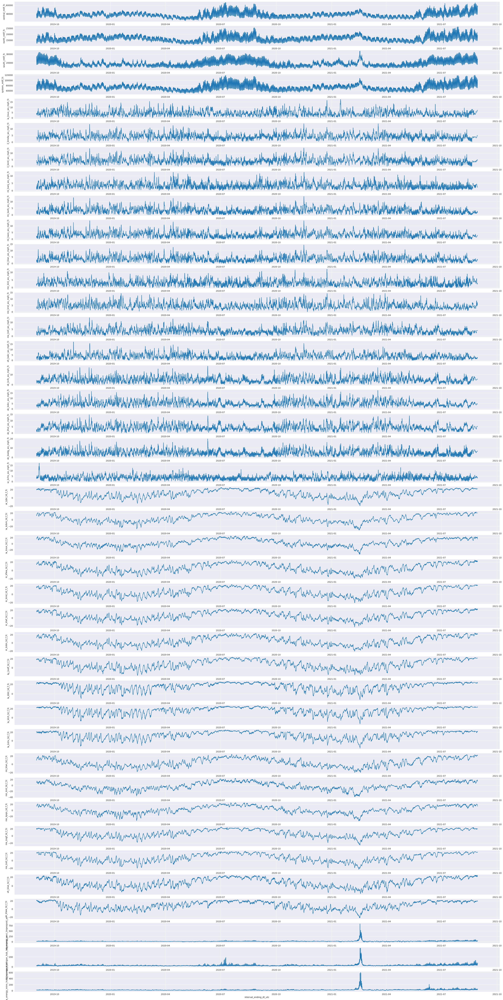

In [15]:
columns = df.columns
fig, axes = plt.subplots(len(columns), 1, figsize=(40, 82))

for i, col in enumerate(columns):
    sns.lineplot(x=df.index, y=col, data=df, ax=axes[i])
    

### 1.3 Plot Data

In [30]:
def seasonal_plot(X, y, period, freq, ax=None):
    if ax is None:
        _, ax = plt.subplots()
    palette = sns.color_palette("husl", n_colors=X[period].nunique(),)
    ax = sns.lineplot(
        x=freq,
        y=y,
        hue=period,
        data=X,
        ci=False,
        ax=ax,
        palette=palette,
        legend=False,
    )
    ax.set_title(f"Seasonal Plot ({period}/{freq})")
    for line, name in zip(ax.lines, X[period].unique()):
        y_ = line.get_ydata()[-1]
        ax.annotate(
            name,
            xy=(1, y_),
            xytext=(6, 0),
            color=line.get_color(),
            xycoords=ax.get_yaxis_transform(),
            textcoords="offset points",
            size=14,
            va="center",
        )
    return ax


In [52]:
def plot_periodogram(ts, detrend='linear', ax=None):
    from scipy.signal import periodogram
    fs = pd.Timedelta(days=365) / pd.Timedelta('1H')
    freqencies, spectrum = periodogram(
        ts,
        fs=fs,
        detrend=detrend,
        window="boxcar",
        scaling='spectrum',
    )
    if ax is None:
        _, ax = plt.subplots()
    ax.step(freqencies, spectrum, color="purple")
    ax.set_xscale("log")
    ax.set_xticks([1, 2, 4, 6, 12, 26, 52, 104, 365])
    ax.set_xticklabels(
        [
            "Annual (1)",
            "Semiannual (2)",
            "Quarterly (4)",
            "Bimonthly (6)",
            "Monthly (12)",
            "Biweekly (26)",
            "Weekly (52)",
            "Semiweekly (104)",
            "Daily (365)",
        ],
        rotation=30,
    )
    ax.ticklabel_format(axis="y", style="sci", scilimits=(0, 0))
    ax.set_ylabel("Variance")
    ax.set_title("Periodogram")
    return ax

#### target variables

From the below plots, we can see that 
- the energy price at different locations are highly correlated in the same market.
    - one model might be enough to predict the energy price at different locations
- density of energy price seems like Gaussian distribution - need to check


/home/yyf/miniconda3/envs/tts-tf/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


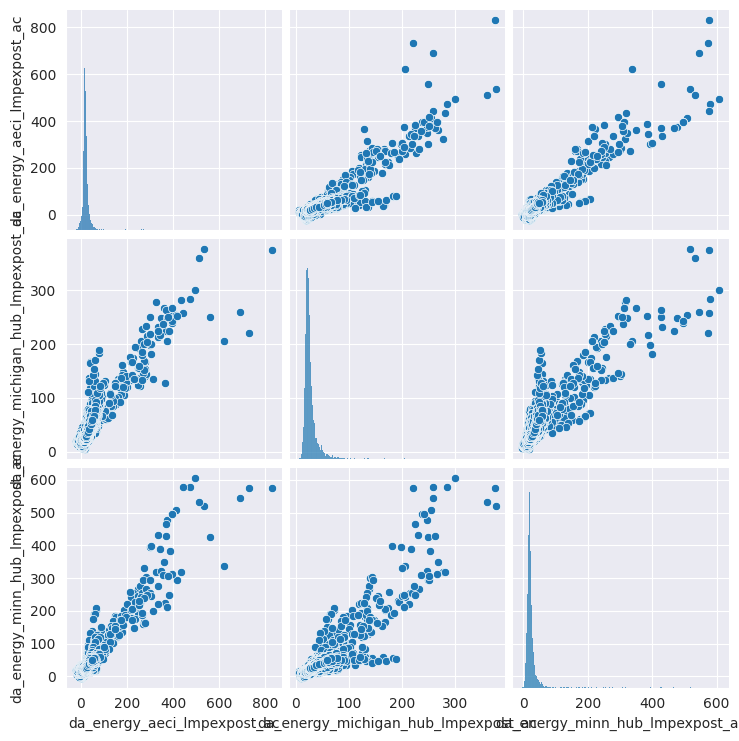

In [16]:
targets = df[target_names]
sns.pairplot(targets)

                        central_mtlf_fc  north_mtlf_fc  south_mtlf_fc  \
interval_ending_dt_utc                                                  
2019-09-01 00:00:00             39290.0        16050.0        27040.0   
2019-09-01 01:00:00             39644.0        15757.0        25871.0   
2019-09-01 02:00:00             39184.0        15820.0        25163.0   
2019-09-01 03:00:00             37378.0        15484.0        24112.0   
2019-09-01 04:00:00             35104.0        14701.0        22690.0   

                        system_mtlf_fc  ia_ksux_ws_mph_fc  il_kmdw_ws_mph_fc  \
interval_ending_dt_utc                                                         
2019-09-01 00:00:00            82370.0           4.157354           4.023245   
2019-09-01 01:00:00            81272.0           4.470273           4.023245   
2019-09-01 02:00:00            80167.0           4.157354           3.889137   
2019-09-01 03:00:00            76974.0           3.889137           3.710326   
2019-09-

/tmp/ipykernel_50026/653072051.py:5: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=('ci', False)` for the same effect.

  ax = sns.lineplot(
/tmp/ipykernel_50026/653072051.py:5: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=('ci', False)` for the same effect.

  ax = sns.lineplot(


<Axes: title={'center': 'Seasonal Plot (year/dayofyear)'}, xlabel='dayofyear', ylabel='da_energy_aeci_lmpexpost_ac'>

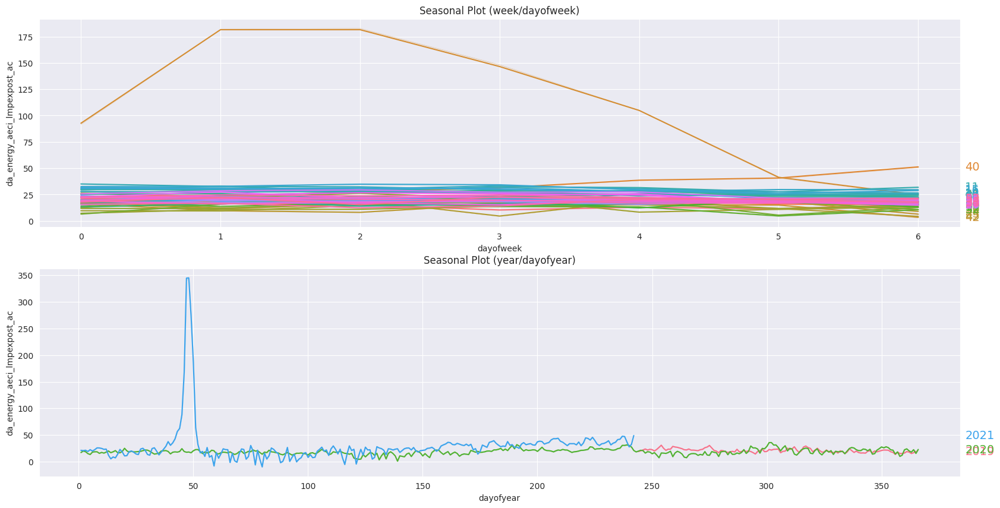

In [46]:
# check if the data has weekly pattern
df['dayofweek'] = df.index.dayofweek
df['week'] = df.index.to_period('H').week
df['year'] = df.index.year
df['dayofyear'] = df.index.dayofyear

# plot the data by day of week
# x-axis is the day of week
# y-axis is the variable for each day of week

fig, (ax0, ax1) = plt.subplots(2 ,1, figsize=(20, 10))
seasonal_plot(df, y="da_energy_aeci_lmpexpost_ac", period="week", freq="dayofweek", ax=ax0)
seasonal_plot(df, y="da_energy_aeci_lmpexpost_ac", period="year", freq="dayofyear", ax=ax1)

<Axes: title={'center': 'Periodogram'}, ylabel='Variance'>

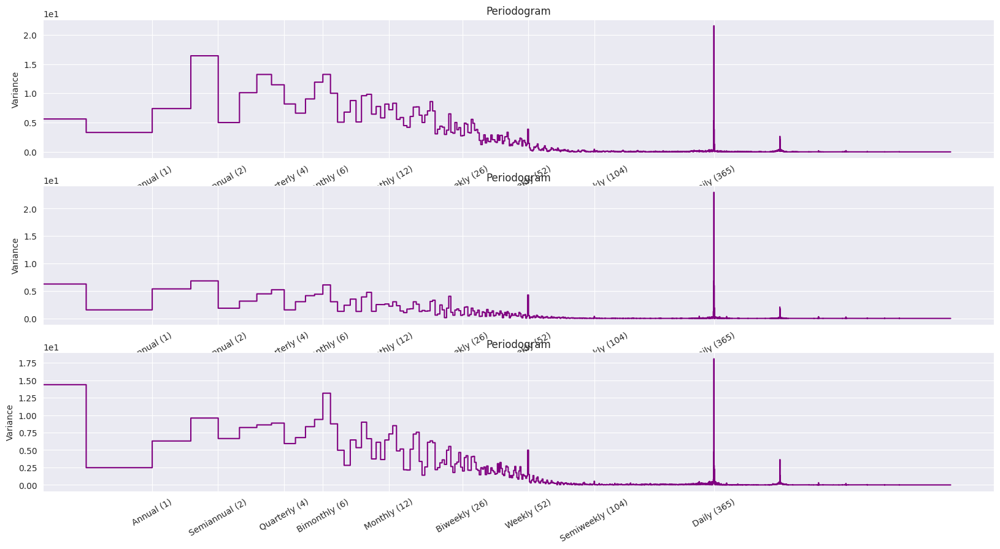

In [53]:
# use the periodogram to check the dominant frequency of the data
df_copy = df.copy()
df_copy.index = df_copy.index.to_period('H')
fig, axes = plt.subplots(3,1, figsize=(20, 10))
plot_periodogram(df['da_energy_aeci_lmpexpost_ac'], ax=axes[0])
plot_periodogram(df['da_energy_michigan_hub_lmpexpost_ac'], ax=axes[1])
plot_periodogram(df['da_energy_minn_hub_lmpexpost_ac'], ax=axes[2])


The energy price seems has outliers with very high values. We need to check if these are valid data points.
- assume this data is directly from the energy market, we can assume these are valid data points
- some of the prices are negative, which is also valid for electricity market

**Notes**
- Forcasting with outliers
    - choose the right loss function
        - l2 loss is sensitive to outliers
        - l1 loss is robost to outliers
- Target labels are right skewed
    - log transform the target labels
    - use quantile loss function ?

#### load names
- the load are also highly correlated
    - we need check the colinearity between features

/home/yyf/miniconda3/envs/tts-tf/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


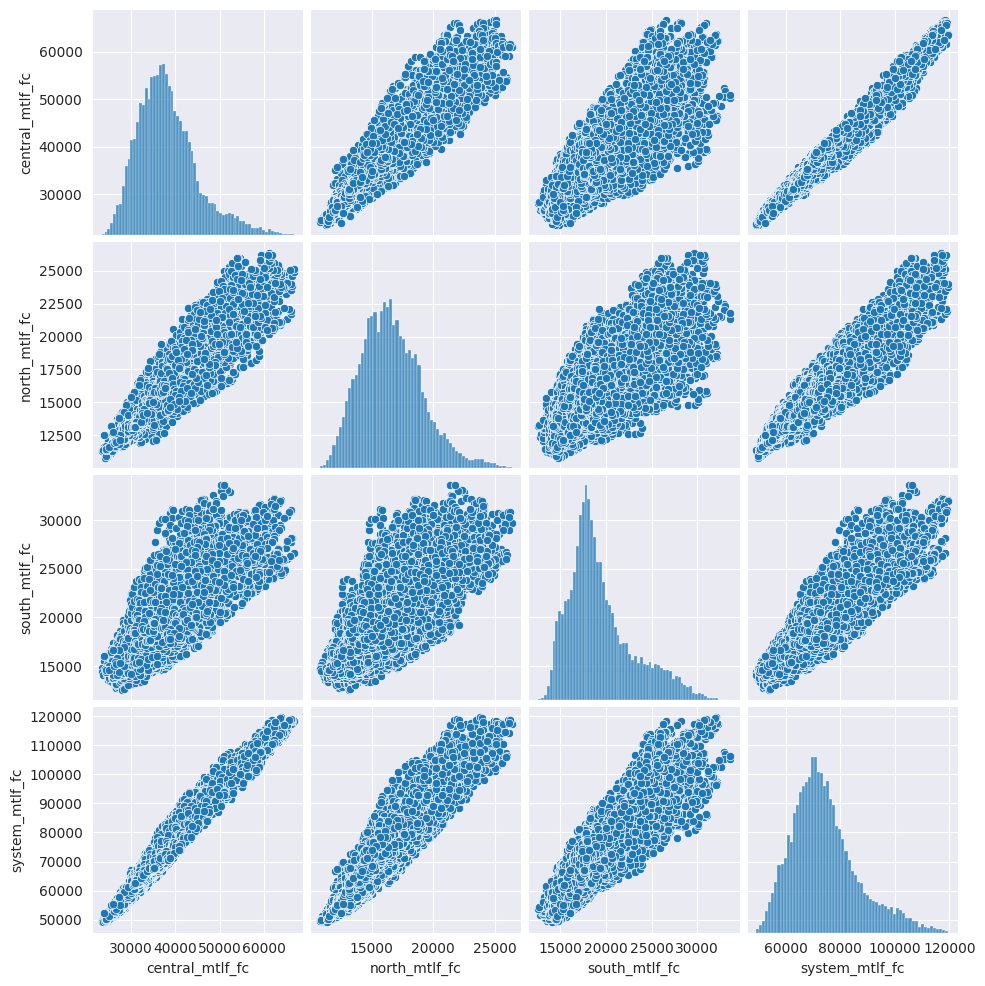

In [ ]:
loads = df[load_names]

sns.pairplot(loads)

/tmp/ipykernel_42015/4060295127.py:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(xlabels, rotation=45)


[Text(18170.0, 0, '2019-10'),
 Text(18262.0, 0, '2020-01'),
 Text(18353.0, 0, '2020-04'),
 Text(18444.0, 0, '2020-07'),
 Text(18536.0, 0, '2020-10'),
 Text(18628.0, 0, '2021-01'),
 Text(18718.0, 0, '2021-04'),
 Text(18809.0, 0, '2021-07'),
 Text(18901.0, 0, '2021-10')]

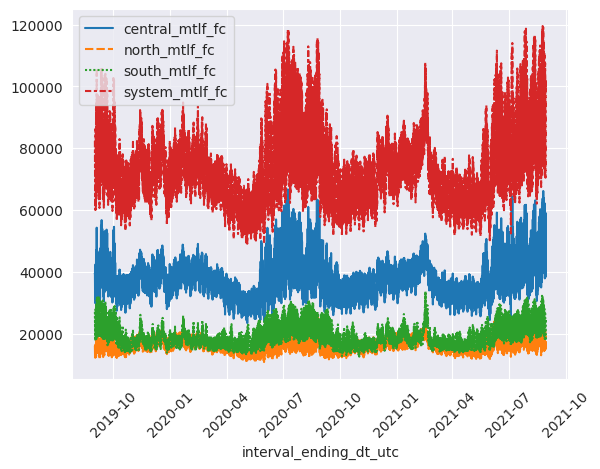

In [ ]:
ax = sns.lineplot(data = loads)
xticks = ax.xaxis.get_major_ticks()
xlabels = ax.xaxis.get_ticklabels()
ax.set_xticklabels(xlabels, rotation=45)

Text(0, 0.5, '%')

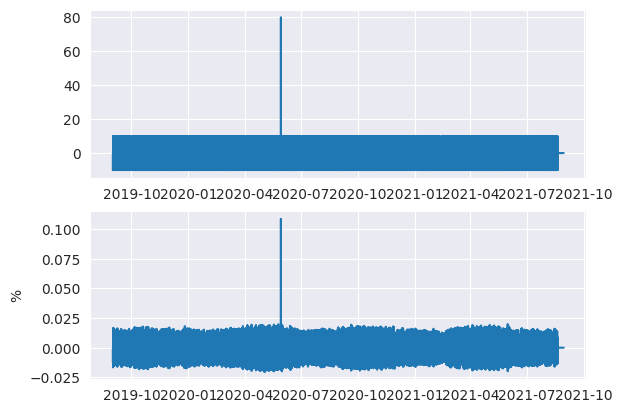

In [ ]:
diff_loads = pd.DataFrame()
diff_loads['diff'] = loads['system_mtlf_fc'] - loads[['central_mtlf_fc', 'north_mtlf_fc', 'south_mtlf_fc']].sum(axis=1)
diff_loads['rel_diff'] = diff_loads['diff']/loads['system_mtlf_fc']

plt.subplot(2,1,1)
plt.plot(diff_loads.index, diff_loads['diff'])

plt.subplot(2,1,2)
plt.plot(diff_loads.index, diff_loads['rel_diff']*100)
plt.ylabel('%')
#rediff_loads/loads['system_mtlf_fc']

<Axes: title={'center': 'Periodogram'}, ylabel='Variance'>

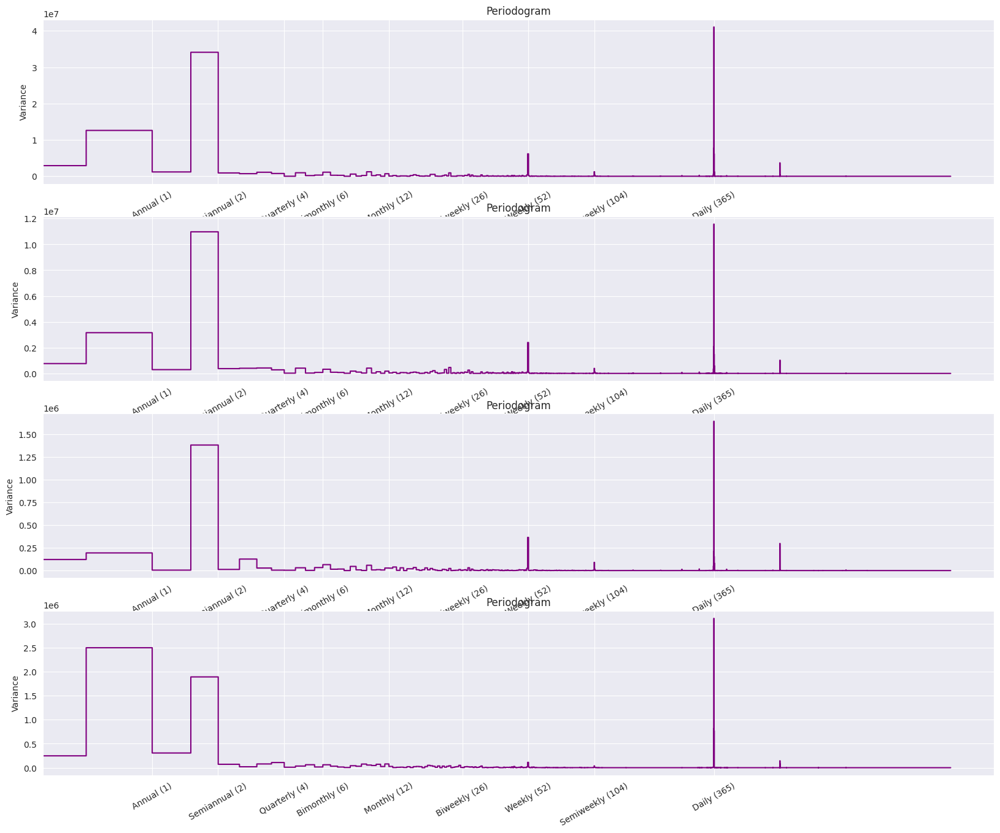

In [55]:
# check the dominant frequency of the data
fig, axes = plt.subplots(4,1, figsize=(20, 16))
plot_periodogram(df['system_mtlf_fc'], ax=axes[0])
plot_periodogram(df['central_mtlf_fc'], ax=axes[1])
plot_periodogram(df['north_mtlf_fc'], ax=axes[2])
plot_periodogram(df['south_mtlf_fc'], ax=axes[3])

#### wind names
- we can see some of the wind are highly correlated
    - we need check the colinearity between features


/home/yyf/miniconda3/envs/tts-tf/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


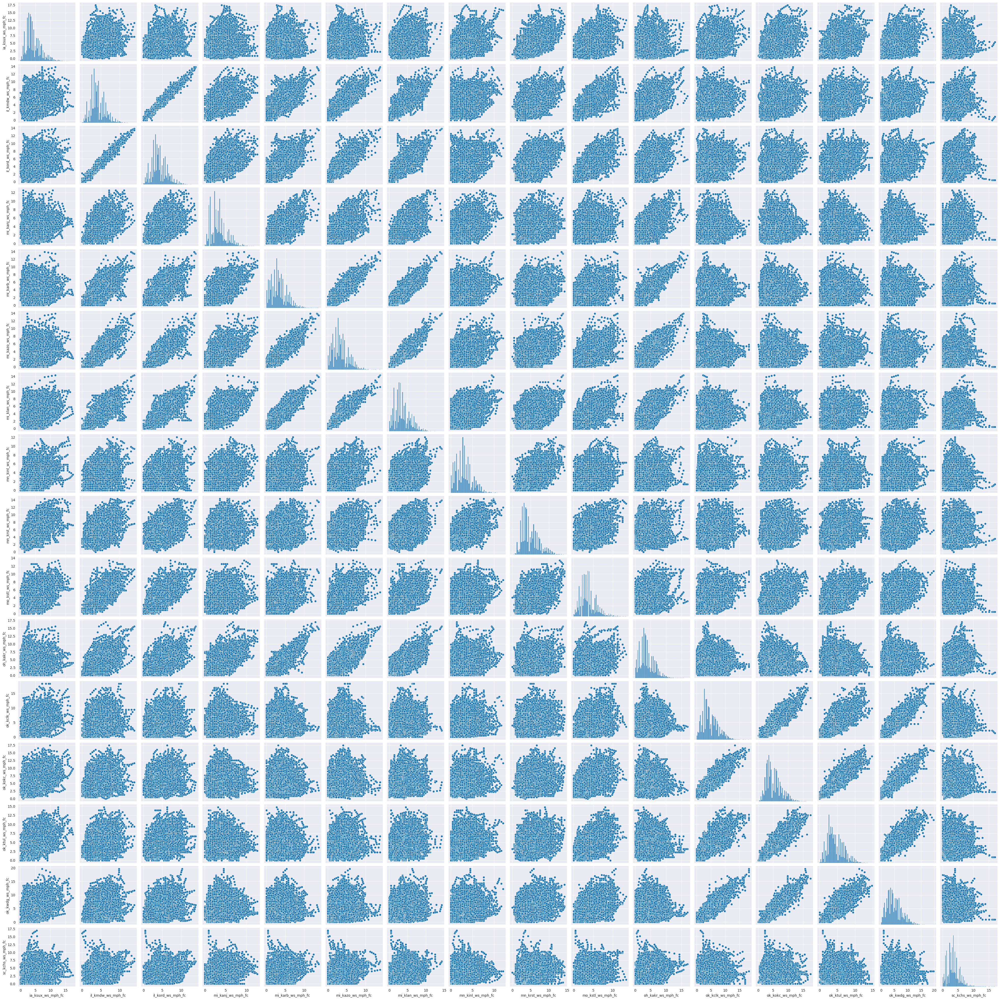

In [ ]:
winds = df[wind_names]
sns.pairplot(winds)

<Axes: title={'center': 'Periodogram'}, ylabel='Variance'>

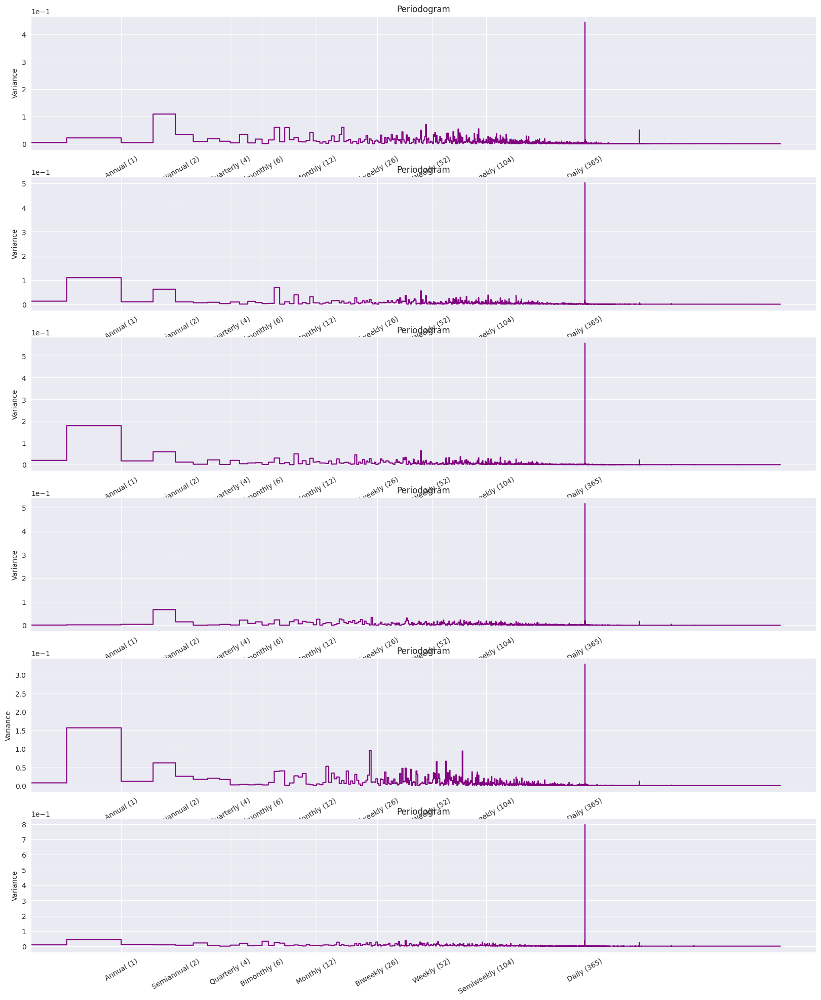

In [58]:
# check the dominant frequency of the data
fig, axes = plt.subplots(6,1, figsize=(20, 24))
plot_periodogram(df['ia_ksux_ws_mph_fc'], ax=axes[0])
plot_periodogram(df['il_kord_ws_mph_fc'], ax=axes[1])
plot_periodogram(df['mi_klan_ws_mph_fc'], ax=axes[2])
plot_periodogram(df['mn_kinl_ws_mph_fc'], ax=axes[3])
plot_periodogram(df['ok_ktul_ws_mph_fc'], ax=axes[4])
plot_periodogram(df['sc_kchs_ws_mph_fc'], ax=axes[5])

#### dewpoint names


/home/yyf/miniconda3/envs/tts-tf/lib/python3.9/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


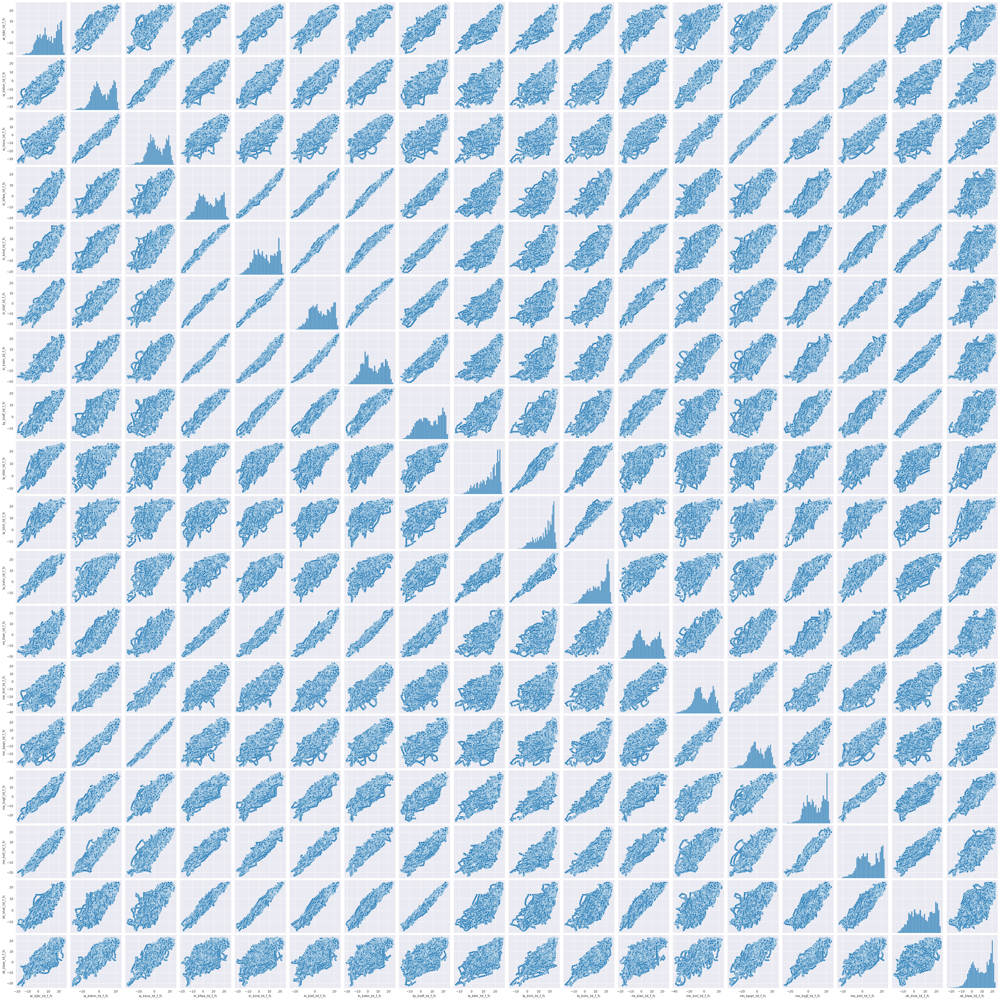

In [ ]:
dewpoints = df[dewpoint_names]
sns.pairplot(dewpoints)

<Axes: title={'center': 'Periodogram'}, ylabel='Variance'>

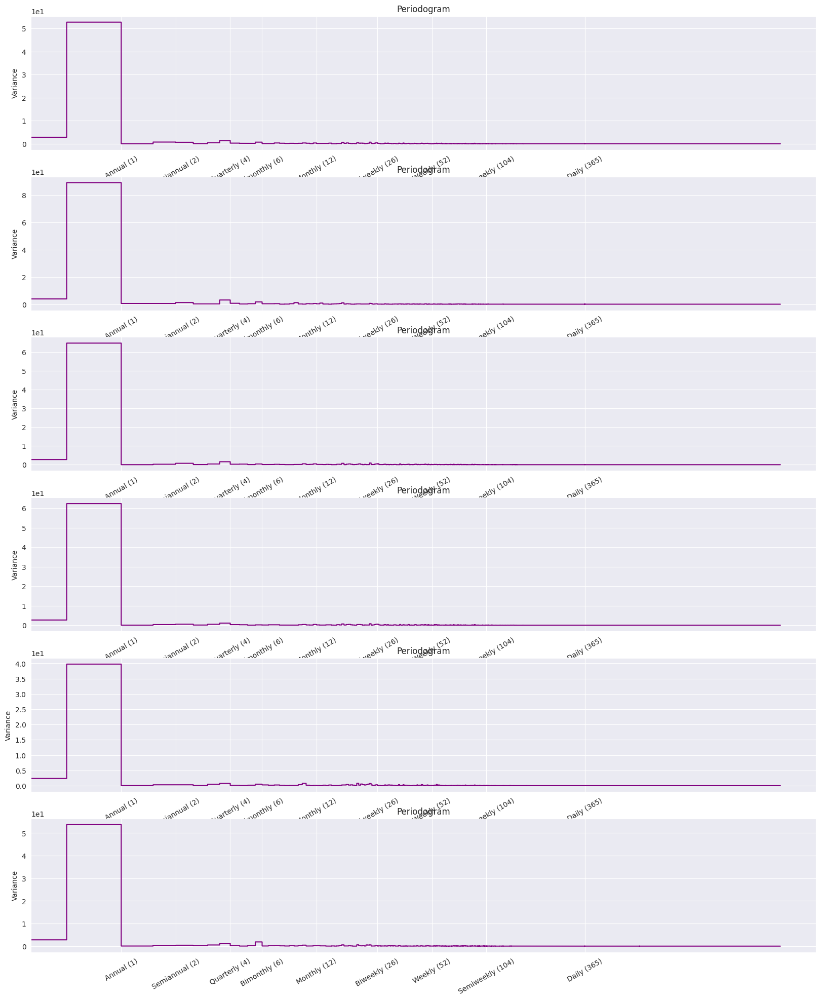

In [60]:
# check the dominant frequency of the data
fig, axes = plt.subplots(6,1, figsize=(20, 24))
plot_periodogram(df['ar_kjbr_td_f_fc'], ax=axes[0])
plot_periodogram(df['ia_ksux_td_f_fc'], ax=axes[1])
plot_periodogram(df['in_kind_td_f_fc'], ax=axes[2])
plot_periodogram(df['ky_ksdf_td_f_fc'], ax=axes[3])
plot_periodogram(df['la_kshv_td_f_fc'], ax=axes[4])
plot_periodogram(df['ok_klaw_td_f_fc'], ax=axes[5])

### 1.4 Summary

After inspection, we can summarize that the data needs to be preprocessed for model training, including
- colinear features in load, wind and dewpoint
    - we can perform PCA to remove the multicolinearity
- the target variables are highly correlated
    - we may use one model to predict the energy price at different locations
- the target variables are right skewed
    - we can log transform the target variables
- the target variables have outliers
    - choose the right loss function
        - l1 loss
        - quantile loss

## 2 Feature Engineering

### 2.1 Time

Date time might be helpful for the model to learn the seasonality and trend of the time series.

But this might be helpful as well because the electrity price is mainly related to the demand and supply of the electricity.
The demand is related to the load, which is related to the time of the day and the day of the week, and the weather conditions.
The supply is also related to the weather conditions. 
For example, if the weather is too cold, the gas or wind turbines might not work well to generate enough electricity.

To find what frequency is the best for the time series, we can plot the autocorrelation plot.


2023-07-20 21:42:27.799817: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-07-20 21:42:27.819899: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-20 21:42:28.096307: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
2023-07-20 21:42:28.531637: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:996] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.

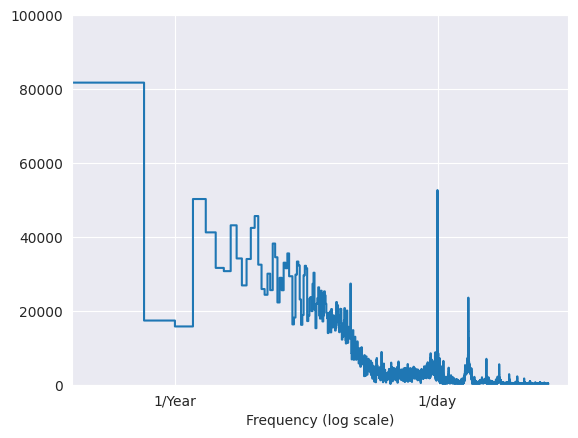

In [62]:
import tensorflow as tf
fft = tf.signal.rfft(df['da_energy_minn_hub_lmpexpost_ac'])
f_per_dataset = np.arange(0, len(fft))

n_samples_h = len(df['da_energy_minn_hub_lmpexpost_ac'])
hours_per_year = 24*365
years_per_dataset = n_samples_h/(hours_per_year)

f_per_year = f_per_dataset/years_per_dataset
plt.step(f_per_year, np.abs(fft))
plt.xscale('log')
plt.ylim(0, 100000)
plt.xlim([0.1, max(plt.xlim())])
plt.xticks([1, 365], labels=['1/Year', '1/day'])
_ = plt.xlabel('Frequency (log scale)')


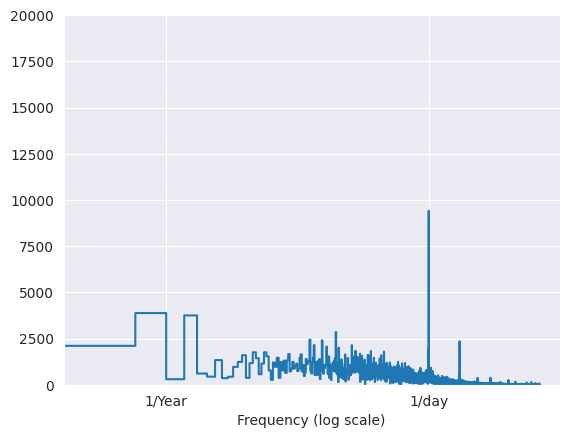

In [63]:
# wind speed 
fft = tf.signal.rfft(df['mi_kanj_ws_mph_fc'])
f_per_dataset = np.arange(0, len(fft))

n_samples_h = len(df['mi_kanj_ws_mph_fc'])
hours_per_year = 24*365.2425
years_per_dataset = n_samples_h/(hours_per_year)

f_per_year = f_per_dataset/years_per_dataset
plt.step(f_per_year, np.abs(fft))
plt.xscale('log')
plt.ylim(0, 20000)
plt.xlim([0.1, max(plt.xlim())])
plt.xticks([1, 365.2425], labels=['1/Year', '1/day'])
_ = plt.xlabel('Frequency (log scale)')


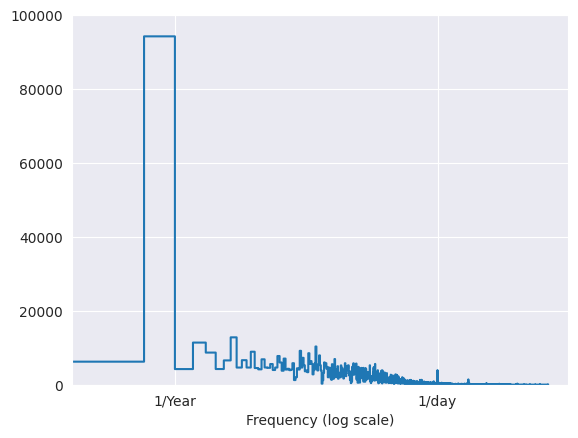

In [64]:
# dew point
fft = tf.signal.rfft(df['ar_kjbr_td_f_fc'])
f_per_dataset = np.arange(0, len(fft))

n_samples_h = len(df['ar_kjbr_td_f_fc'])
hours_per_year = 24*365
years_per_dataset = n_samples_h/(hours_per_year)

f_per_year = f_per_dataset/years_per_dataset
plt.step(f_per_year, np.abs(fft))
plt.xscale('log')
plt.ylim(0, 100000)
plt.xlim([0.1, max(plt.xlim())])
plt.xticks([1, 365], labels=['1/Year', '1/day'])
_ = plt.xlabel('Frequency (log scale)')

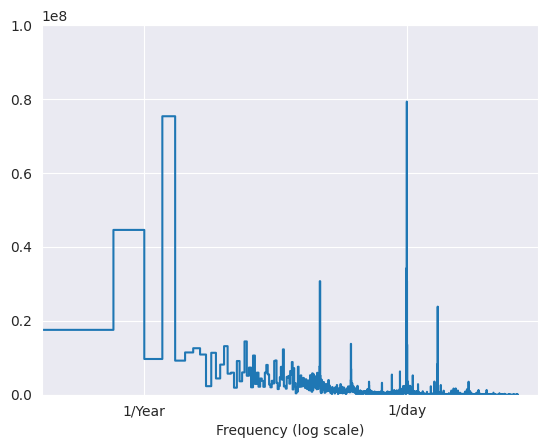

In [65]:
# load 
fft = tf.signal.rfft(df['system_mtlf_fc'])
f_per_dataset = np.arange(0, len(fft))

n_samples_h = len(df['system_mtlf_fc'])
hours_per_year = 24*365
years_per_dataset = n_samples_h/(hours_per_year)

f_per_year = f_per_dataset/years_per_dataset
plt.step(f_per_year, np.abs(fft))
plt.xscale('log')
plt.ylim(0, 1e8)
plt.xlim([0.1, max(plt.xlim())])
plt.xticks([1, 365], labels=['1/Year', '1/day'])
_ = plt.xlabel('Frequency (log scale)')

In [71]:
date_time = df.index
timestamp_s = date_time.map(pd.Timestamp.timestamp)

# the data has obvious daily pattern, bimonth pattern and annual pattern
day = 24*60*60
bimonth = (365.2425/6)*day
year = (365.2425)*day

# use cos/sin as 0 should be close to 23
df['day_sin'] = np.sin(timestamp_s * (2 * np.pi / day))
df['day_cos'] = np.cos(timestamp_s * (2 * np.pi / day))
df['bimonth_sin'] = np.sin(timestamp_s * (2 * np.pi / bimonth))
df['bimonth_cos'] = np.cos(timestamp_s * (2 * np.pi / bimonth))
df['year_sin'] = np.sin(timestamp_s * (2 * np.pi / year))
df['year_cos'] = np.cos(timestamp_s * (2 * np.pi / year))


Text(0.5, 0, 'Time [h]')

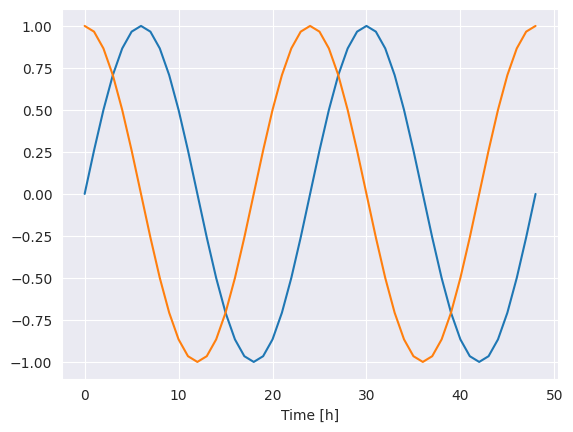

In [68]:
plt.plot(np.array(df['day_sin'])[:49])
plt.plot(np.array(df['day_cos'])[:49])
plt.xlabel('Time [h]')

Text(0.5, 0, 'Time [h]')

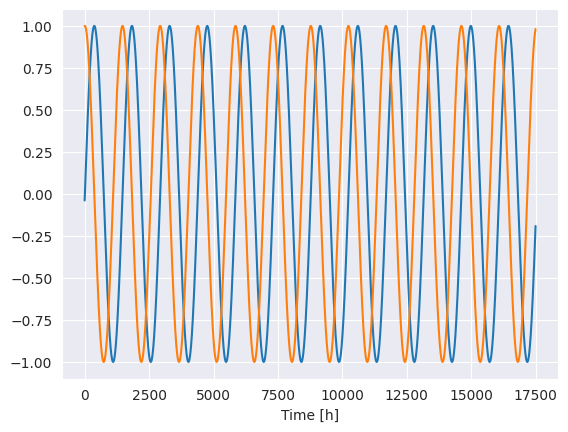

In [73]:
plt.plot(np.array(df['bimonth_sin']))
plt.plot(np.array(df['bimonth_cos']))
plt.xlabel('Time [h]')

Text(0.5, 0, 'Time [h]')

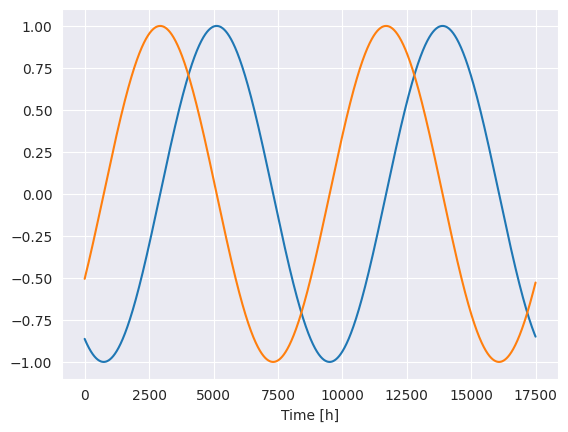

In [ ]:
plt.plot(np.array(df['year_sin'])[:])
plt.plot(np.array(df['year_cos'])[:])
plt.xlabel('Time [h]')

In [69]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
central_mtlf_fc,17497.0,3.828241e+04,6844.281408,23420.000000,33460.000000,3.735400e+04,41900.000000,66680.000000
north_mtlf_fc,17497.0,1.659917e+04,2496.583698,10790.000000,14810.000000,1.638000e+04,18156.000000,26390.000000
south_mtlf_fc,17497.0,1.943489e+04,3622.155051,12540.000000,16990.000000,1.854000e+04,21154.000000,33600.000000
system_mtlf_fc,17497.0,7.431579e+04,12211.229965,49090.000000,65850.000000,7.246000e+04,80486.000000,119545.000000
ia_ksux_ws_mph_fc,17497.0,4.364457e+00,2.470496,0.000000,2.682164,3.889137e+00,5.811354,17.434063
il_kmdw_ws_mph_fc,17497.0,4.219384e+00,1.941427,0.000000,2.816272,3.889137e+00,5.364327,13.857845
il_kord_ws_mph_fc,17497.0,4.177644e+00,2.028929,0.000000,2.816272,3.889137e+00,5.364327,13.857845
mi_kanj_ws_mph_fc,17497.0,3.331537e+00,1.917858,0.000000,1.922217,3.129191e+00,4.157354,12.516764
mi_karb_ws_mph_fc,17497.0,3.269896e+00,2.042512,0.000000,1.788109,3.129191e+00,4.470273,13.857845
mi_kazo_ws_mph_fc,17497.0,3.302846e+00,2.018022,0.000000,1.788109,3.129191e+00,4.470273,13.857845
